In [ ]:
 from PIL import Image
import cv2
import numpy as np
from skimage.transform import resize
from ultralytics import YOLO

# Пути к файлам
model_path = "/Users/Moldir/Downloads/best.pt"  # Модель YOLOv8
mask_path = "/Users/Moldir/Downloads/mask_1920_1080.png"
video_path = "/Users/Moldir/Downloads/parking_1920_1080_loop.mp4"

# Загрузка модели YOLOv8
MODEL = YOLO(model_path)

# Определение статусов парковочных мест
EMPTY = True
NOT_EMPTY = False


def empty_or_not(spot_bgr):
    # Преобразуем изображение до нужного размера
    img_resized = resize(spot_bgr, (224, 224))  # Resize to 224x224
    img_resized = np.float32(img_resized) / 255.0  # Нормализуем

    # Преобразуем обратно в формат, который ожидает YOLO
    img_resized = np.moveaxis(img_resized, -1, 0)  # Меняем размерность (HWC -> CHW)

    # Предсказание
    results = MODEL(img_resized)

    # Проверяем предсказания
    predictions = results.pandas().xywh[0]
    if predictions.empty:
        return EMPTY  # Если ничего не найдено, место пустое
    else:
        return NOT_EMPTY  # Если есть объекты, то место занято


# Функция для обработки видео
def process_video():
    cap = cv2.VideoCapture(video_path)
    frame_nmr = 0  # Номер текущего кадра
    step = 30  # Каждый какой кадр анализировать
    previous_frame = None  # Предыдущий кадр для вычисления разницы
    spots_status = []  # Статусы парковочных мест

    while True:
        ret, frame = cap.read()  # Считываем кадр из видео
        if not ret:
            break  # Если кадры закончились, выходим

        if frame_nmr % step == 0 and previous_frame is not None:
            for spot_indx, spot in enumerate(spots_status):
                x1, y1, w, h = spot
                # Вырезаем участок (парковочное место)
                spot_crop = frame[y1:y1 + h, x1:x1 + w, :]
                spots_status[spot_indx] = empty_or_not(spot_crop)

        if frame_nmr % step == 0:
            previous_frame = frame.copy()

        # Отрисовываем прямоугольники на парковочных местах
        for spot_indx, spot in enumerate(spots_status):
            x1, y1, w, h = spot
            color = (0, 255, 0) if spots_status[spot_indx] == EMPTY else (0, 0, 255)
            frame = cv2.rectangle(frame, (x1, y1), (x1 + w, y1 + h), color, 2)

        # Показываем кадр
        cv2.imshow('frame', frame)
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break

        frame_nmr += 1  # Увеличиваем номер кадра

    cap.release()
    cv2.destroyAllWindows()


# Запуск обработки видео
process_video()


In [ ]:
import pickle
import cv2
import numpy as np
from skimage.transform import resize  #размер изображений

##файлы
model_path = "/Users/Moldir/Downloads/model.p"
mask_path = "/Users/Moldir/Downloads/mask_1920_1080.png"
video_path = "/Users/Moldir/Downloads/parking_1920_1080_loop.mp4"

# загрузка заранеее обученной модели 
MODEL = pickle.load(open(model_path, "rb"))

# определение статусов паркингов 
EMPTY = True
NOT_EMPTY = False


# Эта функция определяет, является ли парковочное место пустым
def empty_or_not(spot_bgr):
    flat_data = []  # Создаем пустой список для данных
    img_resized = resize(spot_bgr, (15, 15, 3))  # Уменьшаем изображение до 15x15
    flat_data.append(img_resized.flatten())  # Преобразуем в одномерный массив
    flat_data = np.array(flat_data)  # Преобразуем в numpy массив

    # Используем модель для предсказания
    y_output = MODEL.predict(flat_data)

    # Возвращаем результат
    if y_output == 0:
        return EMPTY  # Пустое место
    else:
        return NOT_EMPTY  # Занятое место


# Эта функция находит координаты всех парковочных мест
def get_parking_spots_bboxes(connected_components):
    totalLabels, label_ids, values, centroid = connected_components

    slots = []  # Список для хранения координат парковочных мест
    for i in range(1, totalLabels):
        x1 = int(values[i, cv2.CC_STAT_LEFT])
        y1 = int(values[i, cv2.CC_STAT_TOP])
        w = int(values[i, cv2.CC_STAT_WIDTH])
        h = int(values[i, cv2.CC_STAT_HEIGHT])

        slots.append([x1, y1, w, h])  # Добавляем координаты в список

    return slots


# Функция сравнивает два изображения и вычисляет их разницу
def calc_diff(im1, im2):
    return np.abs(np.mean(im1) - np.mean(im2))


# Загружаем маску изображения
mask = cv2.imread(mask_path, 0)

# Загружаем видео
cap = cv2.VideoCapture(video_path)

# Находим связанные компоненты на маске (например, области парковочных мест)
connected_components = cv2.connectedComponentsWithStats(mask, 4, cv2.CV_32S)

# Получаем координаты парковочных мест
spots = get_parking_spots_bboxes(connected_components)

# Инициализация вспомогательных массивов
spots_status = [None for _ in spots]  # Храним статусы парковочных мест
diffs = [None for _ in spots]  # Храним разницу кадров для каждого места
previous_frame = None  # Предыдущий кадр для вычисления разницы
frame_nmr = 0  # Номер текущего кадра
step = 30  # Каждый какой кадр анализировать (настраивается для производительности)

# Основной цикл обработки видео
while True:
    ret, frame = cap.read()  # Считываем кадр из видео

    if not ret:
        break  # Если кадры кончились, выходим из цикла

    # Обрабатываем кадр каждые 'step' кадров
    if frame_nmr % step == 0 and previous_frame is not None:
        for spot_indx, spot in enumerate(spots):
            x1, y1, w, h = spot
            # Вырезаем текущий участок (парковочное место)
            spot_crop = frame[y1:y1 + h, x1:x1 + w, :]
            # Вычисляем разницу между текущим и предыдущим кадром
            diffs[spot_indx] = calc_diff(spot_crop, previous_frame[y1:y1 + h, x1:x1 + w, :])

    # Ещё каждые 'step' кадров определяем статус парковочных мест
    if frame_nmr % step == 0:
        if previous_frame is None:
            # Если предыдущего кадра нет (самое начало видео)
            spots_to_check = range(len(spots))
        else:
            # Выбираем места, где изменение значительное
            spots_to_check = [j for j in np.argsort(diffs) if diffs[j] / np.amax(diffs) > 0.4]

        for spot_indx in spots_to_check:
            spot = spots[spot_indx]
            x1, y1, w, h = spot
            # Вырезаем участок и определяем, пустое ли место
            spot_crop = frame[y1:y1 + h, x1:x1 + w, :]
            spots_status[spot_indx] = empty_or_not(spot_crop)

    # Обновляем предыдущий кадр
    if frame_nmr % step == 0:
        previous_frame = frame.copy()

    # Отрисовываем прямоугольники на парковочных местах
    for spot_indx, spot in enumerate(spots):
        spot_status = spots_status[spot_indx]
        x1, y1, w, h = spots[spot_indx]
        if spot_status is None:
            continue
        if spot_status:
            color = (0, 255, 0)  # Зелёный (место свободно)
        else:
            color = (0, 0, 255)  # Красный (место занято)
        frame = cv2.rectangle(frame, (x1, y1), (x1 + w, y1 + h), color, 2)

    # Добавляем текст с числом свободных мест
    cv2.rectangle(frame, (80, 20), (550, 80), (0, 0, 0), -1)  # Чёрный фон
    cv2.putText(frame, f'Available spots: {sum(spots_status)} / {len(spots_status)}', (100, 60),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

    # Показываем кадр
    cv2.imshow('frame', frame)
    if cv2.waitKey(25) & 0xFF == ord('q'):  # Нажмите 'q' для выхода
        break

    frame_nmr += 1  # Увеличиваем номер кадра

# Освобождаем ресурсы
cap.release()
cv2.destroyAllWindows()

/Users/Moldir/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:329: UserWarning: Trying to unpickle estimator SVC from version 1.1.3 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [2]:
!pip install ultralytics


In [3]:
from ultralytics import YOLO

model = YOLO("yolov8n-cls.pt")  

100%|██████████████████████████████████████| 5.31M/5.31M [00:05<00:00, 1.07MB/s]


In [ ]:
model.train(
    data="/content/drive/MyDrive/CV/clf-dataset",
    epochs=5,
    imgsz=224,
    batch=32,
    project="/content/drive/MyDrive/CV/clf-results",
    name="clf_yolo_try2"
)

In [11]:
model_path = YOLO("/Users/Moldir/Downloads/clf-results/clf_yolo_try2/weights/best.pt")
mask_path = "/Users/Moldir/Downloads/mask_1920_1080.png"
image_path = "/Users/Moldir/Downloads/carParkImg.png"


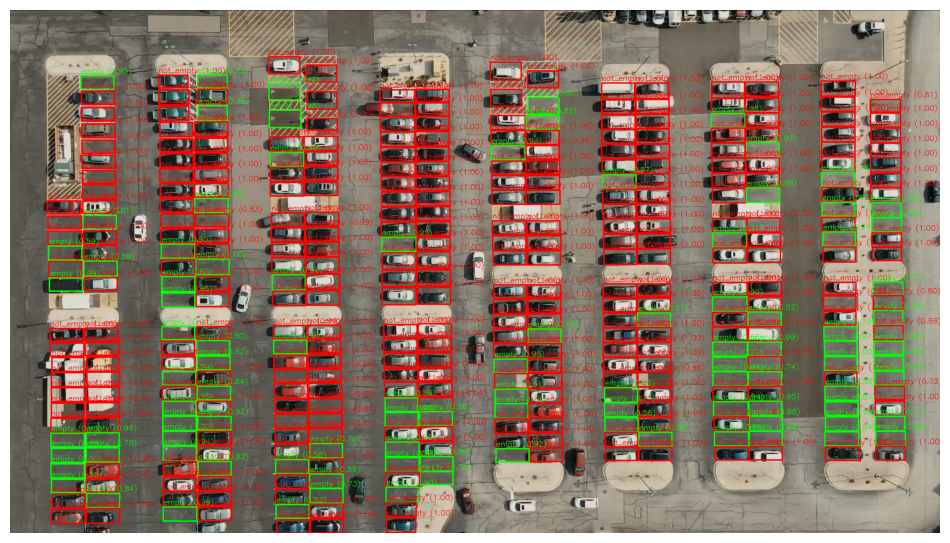

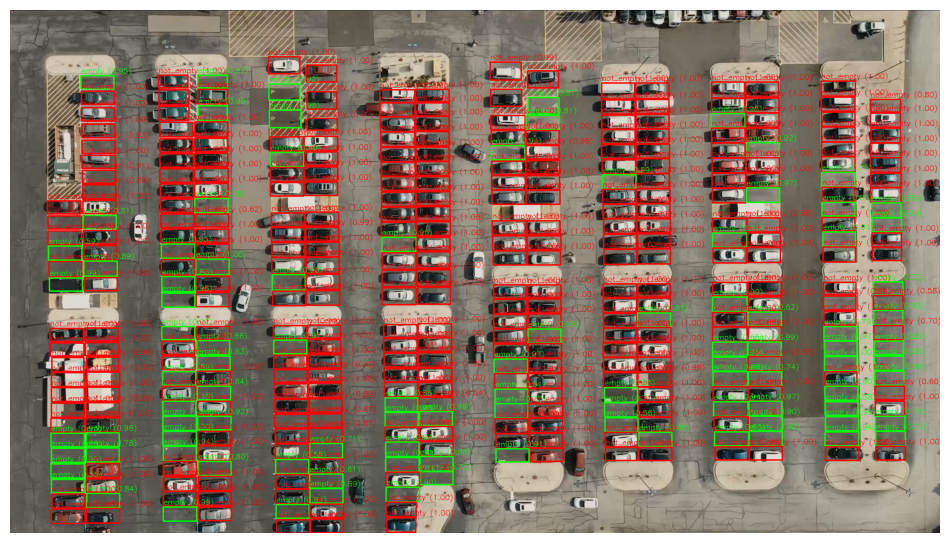

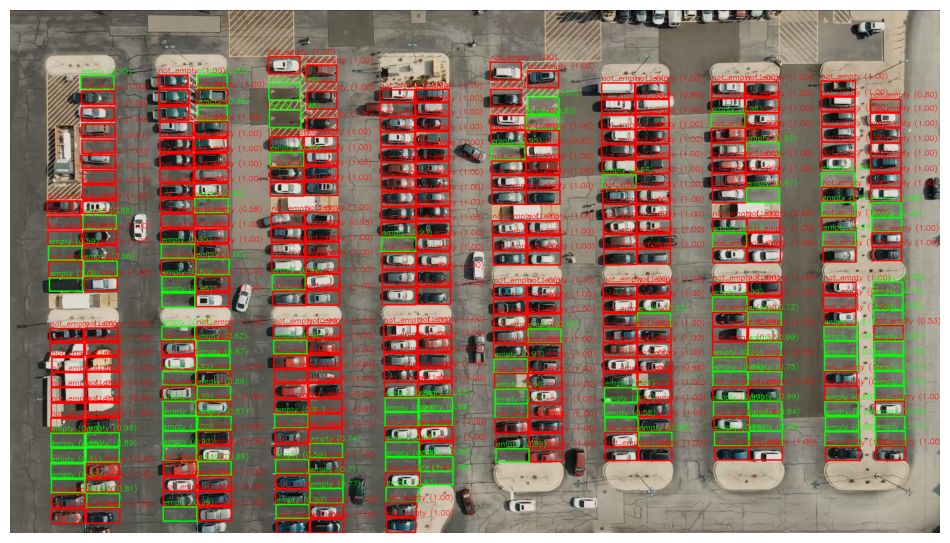

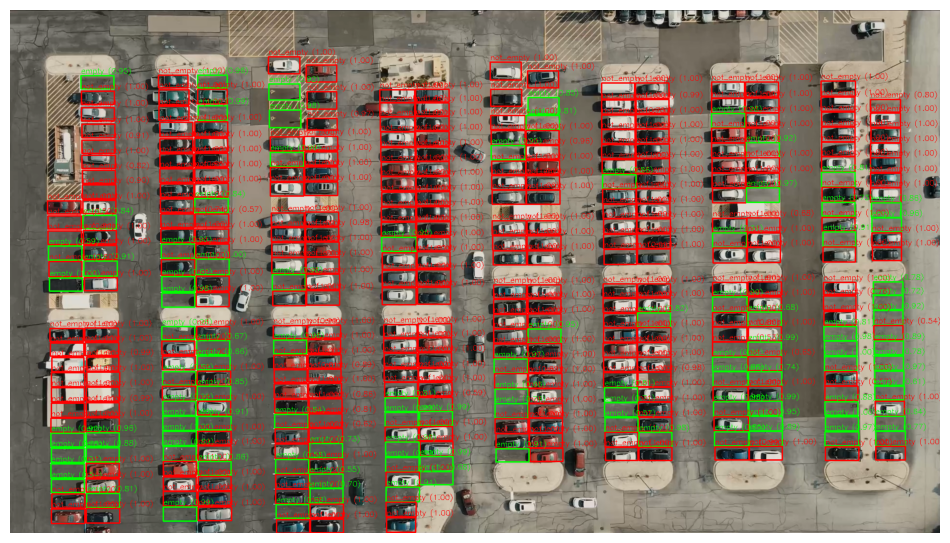

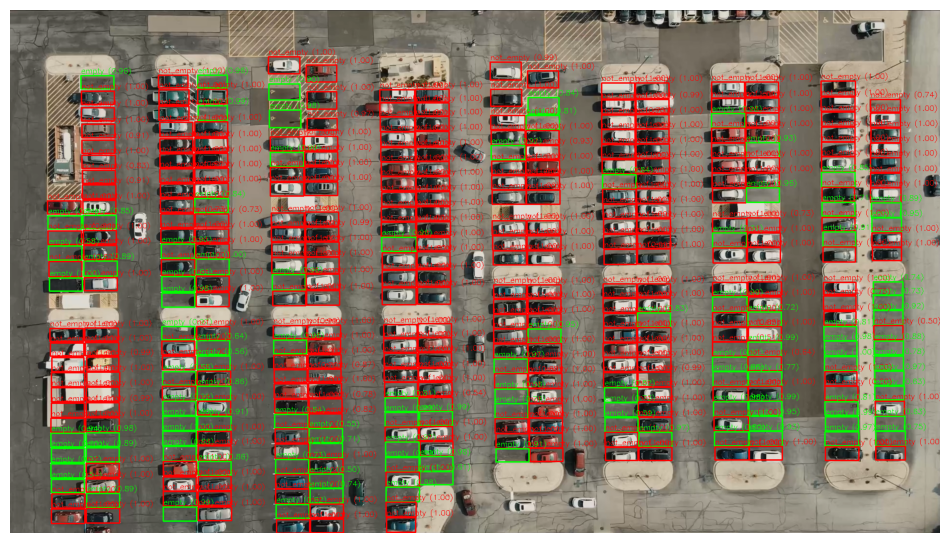

...

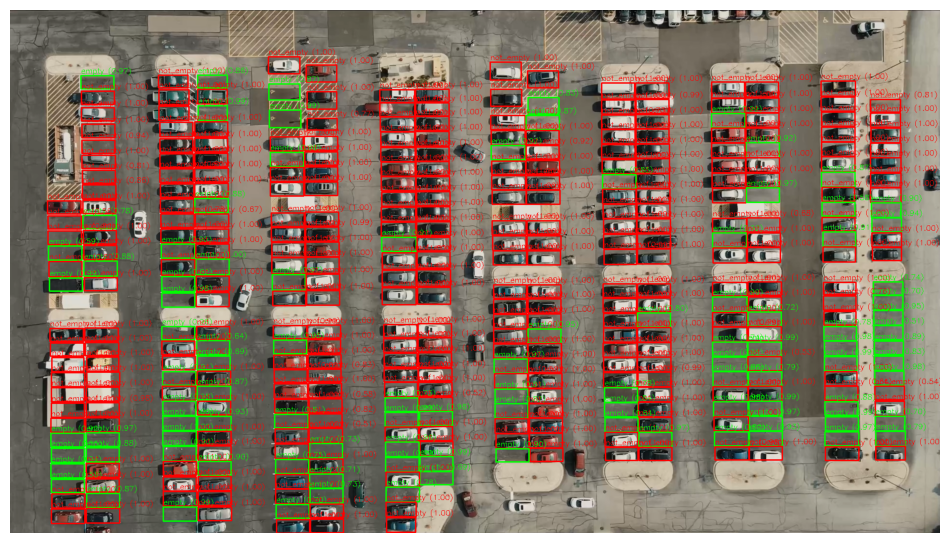

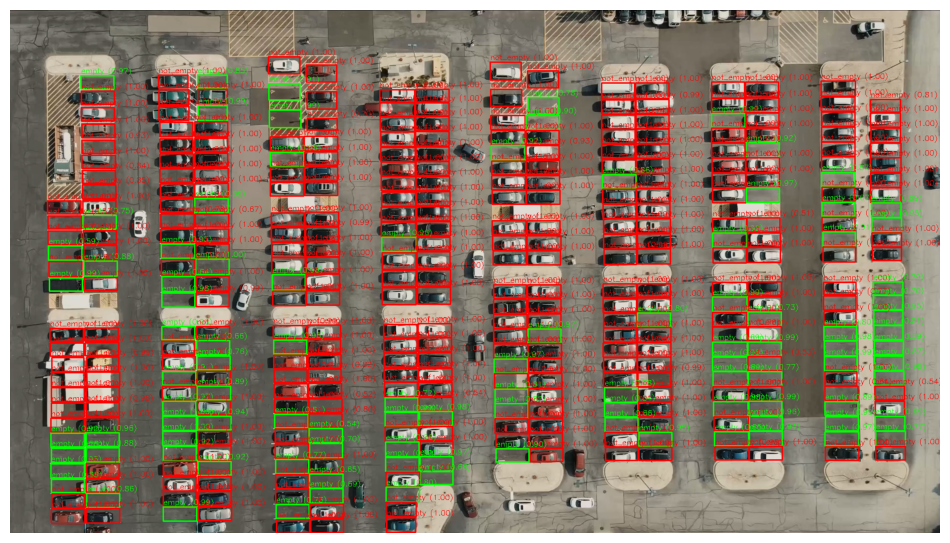

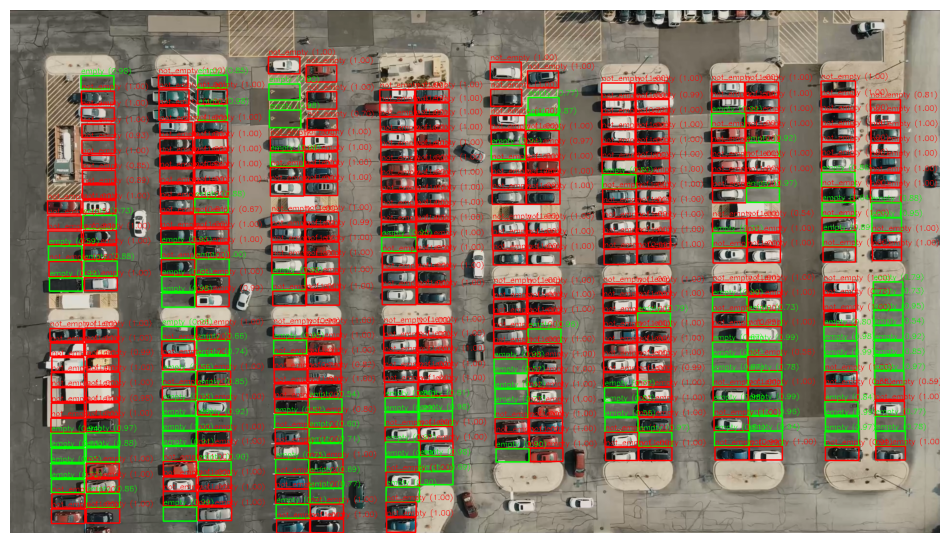

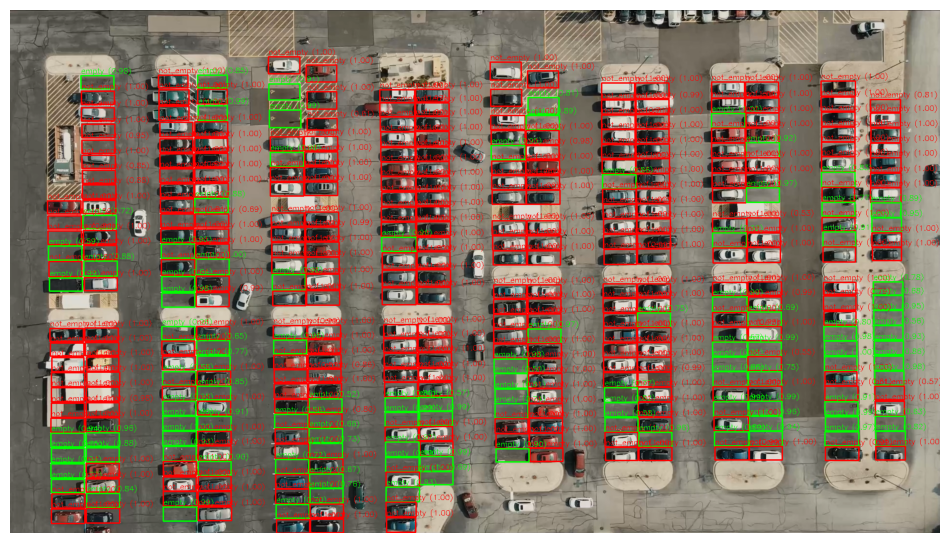

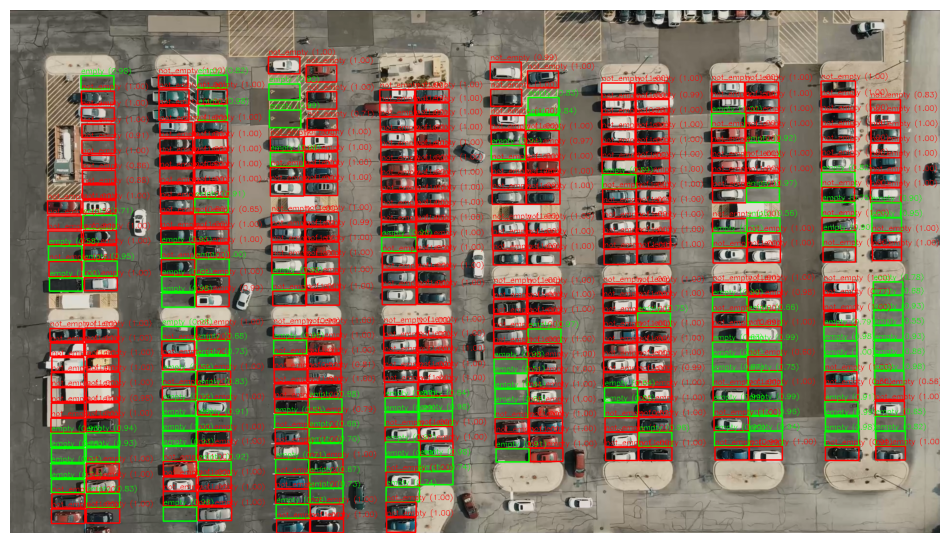

KeyboardInterrupt: 

In [2]:
from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Загружаем модель
model = YOLO("/Users/Moldir/Downloads/clf-results/clf_yolo_try2/weights/best.pt")

# Загружаем маску
mask_path = "/Users/Moldir/Downloads/mask_1920_1080.png"
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

# Находим связанные компоненты на маске
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask)

# Загружаем видео
video_path = "/Users/Moldir/Downloads/parking_1920_1080.mp4"
cap = cv2.VideoCapture(video_path)

# Проходим по кадрам
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)  # Преобразуем в RGB для matplotlib

    # Копия текущего кадра
    annotated_img = frame_rgb.copy()

    # Идем по найденным парковочным местам
    for i in range(1, num_labels):  # 0 — фон
        x1, y1, w, h, area = stats[i]

        crop = frame_rgb[y1:y1+h, x1:x1+w]

        if crop.size == 0:
            continue

        # Предсказание
        result = model.predict(source=crop, imgsz=224, verbose=False)
        label = result[0].names[int(result[0].probs.top1)]
        confidence = float(result[0].probs.top1conf)

        # Цвет в зависимости от класса
        color = (0, 255, 0) if label == "empty" else (255, 0, 0)
        text = f"{label} ({confidence:.2f})"

        # Отрисовка прямоугольника и текста
        cv2.rectangle(annotated_img, (x1, y1), (x1 + w, y1 + h), color, 2)
        cv2.putText(annotated_img, text, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    # Показываем кадр
    plt.figure(figsize=(12, 8))
    plt.imshow(annotated_img)
    plt.axis('off')
    plt.show()

    # Чтобы не грузить ноутбук — можно остановить на нескольких кадрах:
    # Например, после 10 кадров:
    # if frame_count >= 10:
    #     break

# Освобождаем ресурсы
cap.release()


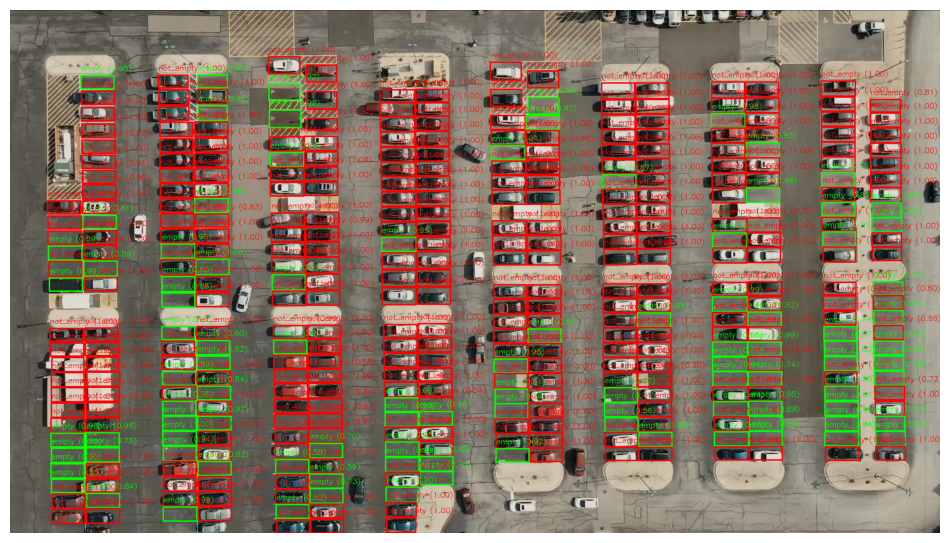

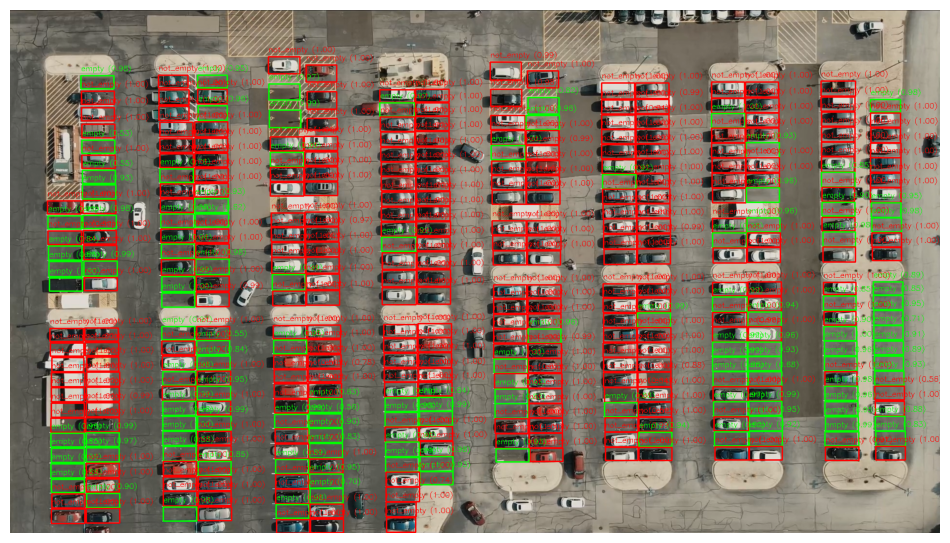

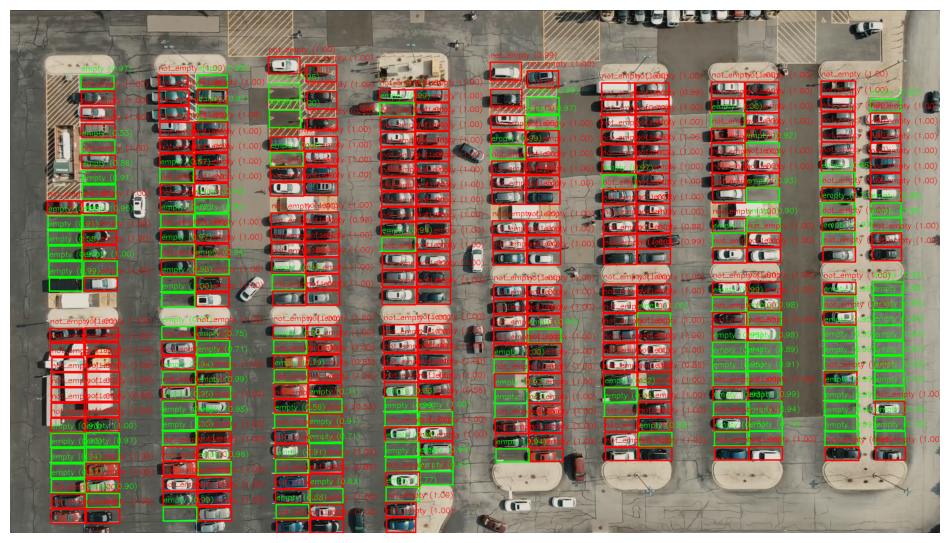

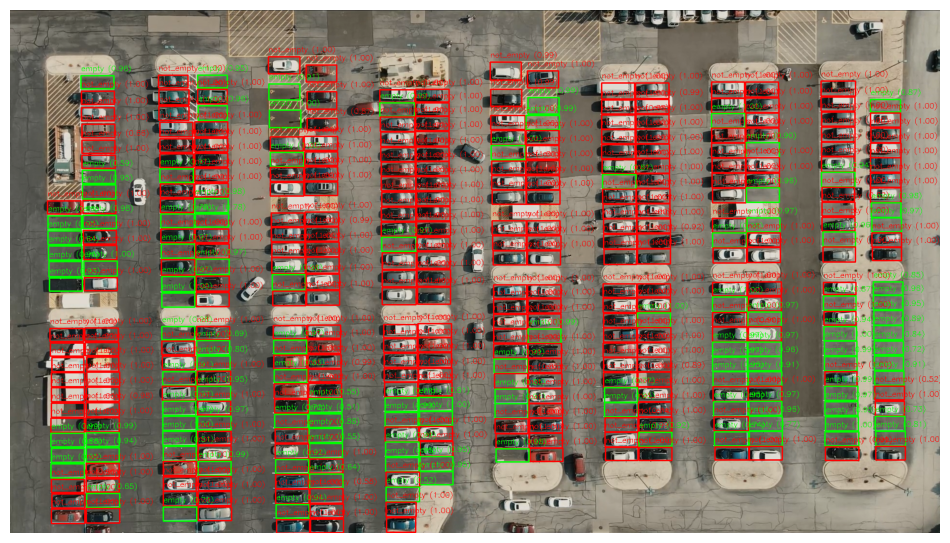

In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Загружаем модель
model = YOLO("/Users/Moldir/Downloads/clf-results/clf_yolo_try2/weights/best.pt")

# Загружаем маску
mask_path = "/Users/Moldir/Downloads/mask_1920_1080.png"
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

# Находим связанные компоненты на маске
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask)

# Загружаем видео
video_path = "/Users/Moldir/Downloads/parking_1920_1080.mp4"
cap = cv2.VideoCapture(video_path)

# Получаем параметры видео (размер, fps)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

# Настраиваем VideoWriter для записи результата
output_path = "/Users/Moldir/Downloads/annotated_output.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # кодек mp4
out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    annotated_img = frame_rgb.copy()

    for i in range(1, num_labels):
        x1, y1, w, h, area = stats[i]
        crop = frame_rgb[y1:y1+h, x1:x1+w]

        if crop.size == 0:
            continue

        result = model.predict(source=crop, imgsz=224, verbose=False)
        label = result[0].names[int(result[0].probs.top1)]
        confidence = float(result[0].probs.top1conf)

        color = (0, 255, 0) if label == "empty" else (255, 0, 0)
        text = f"{label} ({confidence:.2f})"

        cv2.rectangle(annotated_img, (x1, y1), (x1 + w, y1 + h), color, 2)
        cv2.putText(annotated_img, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    # Преобразуем обратно в BGR перед записью
    annotated_img_bgr = cv2.cvtColor(annotated_img, cv2.COLOR_RGB2BGR)
    out.write(annotated_img_bgr)

    # Чтобы в ноутбуке визуализировать каждый 30-й кадр:
    if frame_count % 30 == 0:
        plt.figure(figsize=(12, 8))
        plt.imshow(annotated_img)
        plt.axis('off')
        plt.show()

    frame_count += 1

# Освобождаем ресурсы
cap.release()
out.release()
print(f"✅ Готово! Видео сохранено в {output_path}")
